# Stable Diffusion Model Application

In [1]:
# %pip install tomesd

In [2]:
from diffusers import DiffusionPipeline
from diffusers.utils import make_image_grid

import time
import torch
import tomesd

/home/skim/.pyenv/versions/sd/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [21]:
def get_inputs(prompt, batch_size=1, mode="normal"):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]

    if mode == "turbo":
        return {"prompt": prompts, "generator": generator, "num_inference_steps": 4, "guidance_scale": 0.0}
    else:
        return {"prompt": prompts, "generator": generator, "num_inference_steps": 20}


def sdxl(prompt="", batch_size=2, mode="normal"):
    torch.backends.cuda.matmul.allow_tf32 = True
    start_time = time.time()

    if mode == "turbo":
        model_id = "stabilityai/sdxl-turbo"
    else:
        model_id = "stabilityai/stable-diffusion-xl-base-1.0"
    pipe = DiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16, use_safetensors=True, variant="fp16")

    # pipe.unet = torch.compile(pipe.unet, mode="reduce-overhead", fullgraph=True)
    # pipe.to("cuda")
    pipe.enable_vae_slicing()
    pipe.enable_vae_tiling()
    # pipe.enable_xformers_memory_efficient_attention()
    # pipe.enable_sequential_cpu_offload()
    pipe.enable_model_cpu_offload()
    pipe.unet.to(memory_format=torch.channels_last)
    # tomesd.apply_patch(pipe, ratio=0.5)
    pipe.upcast_vae()

    if prompt == "":
        prompt = "A majestic lion jumping from a big stone at night"

    images = pipe(**get_inputs(prompt, batch_size=batch_size, mode=mode)).images

    print(f"Time: {time.time() - start_time:.2f} sec")

    return make_image_grid(images, rows=2, cols=batch_size // 2)

100%|██████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.40it/s]


Time: 7.51 sec


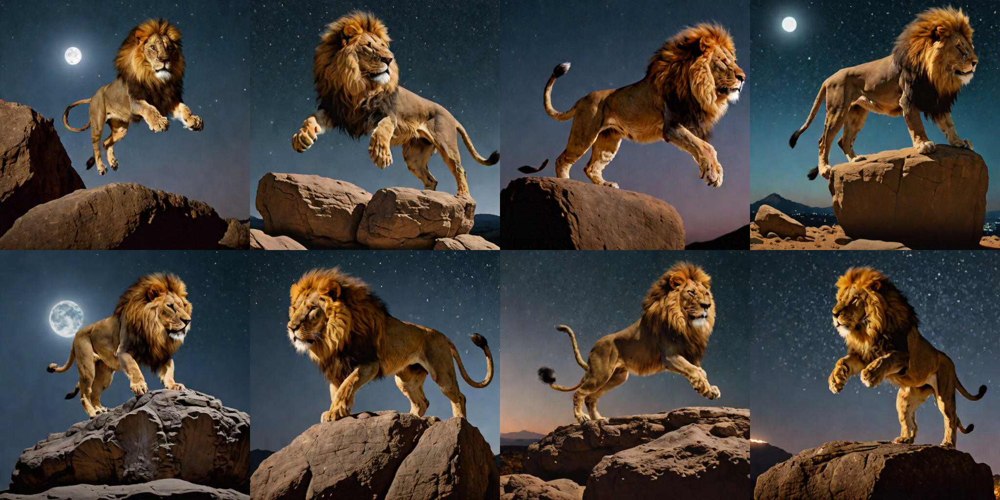

In [22]:
sdxl(batch_size=8, mode="turbo")

# f16, cuda, n=20 -> 13.63 sec
# f16, cuda, n=20, allow_tf32 -> 13.83 sec
# f16, cuda, n=20, allow_tf32, batch 2 -> 30.86 sec
# f16, n=20, allow_tf32, batch 2, cpu seq offload -> 54.43 sec
# f16, n=20, allow_tf32, batch 2, cpu model offload -> 31.44 sec
# f16, n=20, allow_tf32, batch 2, cpu model offload, channel -> 31.67 sec
# f16, n=20, allow_tf32, batch 2, cpu model offload, channel, compile -> 106.59 sec (including compile time)
# f16, n=20, allow_tf32, batch 2, cpu model offload, channel, tomesd -> 33.01 sec

# turbo
# f16, n=4, allow_tf32, batch 4, cpu model offload, channel -> 4.84 sec
# f16, n=4, allow_tf32, batch 8, cpu model offload, channel -> 7.51 sec

100%|██████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.41it/s]


Time: 7.74 sec


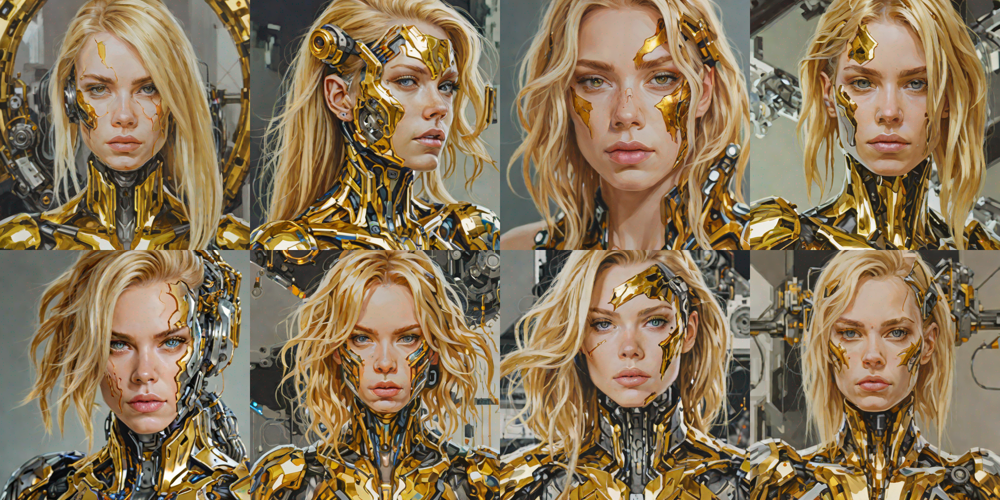

In [23]:
prompt = "Self-portrait oil painting, a beautiful cyborg with golden hair, 8k"
sdxl(prompt, batch_size=8, mode="turbo")

In [8]:
model_id = "stabilityai/stable-diffusion-xl-refiner-1.0"
refiner = DiffusionPipeline.from_pretrained(
    model_id,
    text_encoder_2=base.text_encoder_2,
    vae=base.vae,
    torch_dtype=torch.float16,
    use_safetensors=True,
    variant="fp16",
)
# refiner.to("cuda")
# refiner = ORTStableDiffusionXLImg2ImgPipeline(model_id, export=True, provider="CUDAExecutionProvider")
refiner.unet = torch.compile(refiner.unet, mode="reduce-overhead", fullgraph=True)
refiner.enable_model_cpu_offload()

Loading pipeline components...: 100%|██████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 14.56it/s]


In [9]:
# Define how many steps and what % of steps to be run on each experts (80/20) here
n_steps = 20
high_noise_frac = 0.8

prompt = "A majestic lion jumping from a big stone at night"

In [10]:
# run both experts
image = base(
    prompt=prompt,
    num_inference_steps=n_steps,
    denoising_end=high_noise_frac,
    output_type="latent",
).images
image = refiner(
    prompt=prompt,
    num_inference_steps=n_steps,
    denoising_start=high_noise_frac,
    image=image,
).images[0]

100%|██████████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:03<00:00, 15.82s/it]


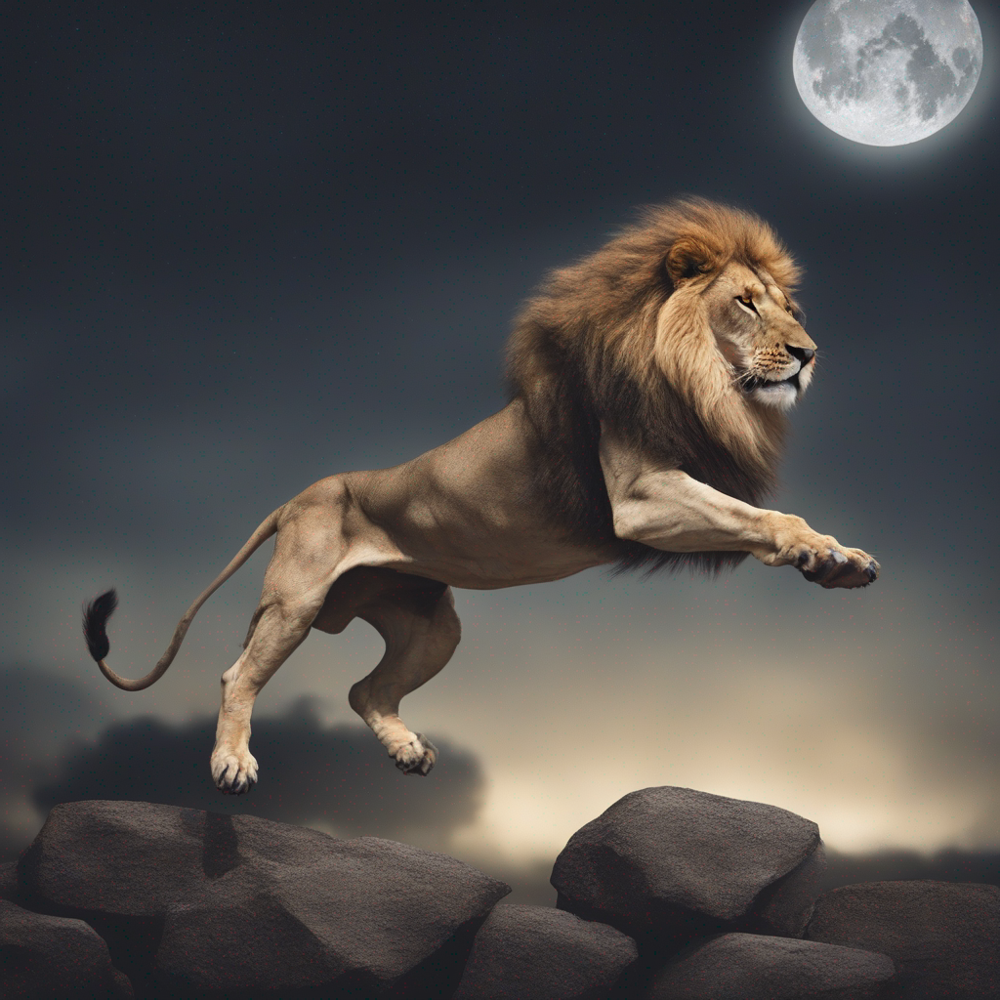

In [11]:
image

100%|██████████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:53<00:00,  6.68s/it]


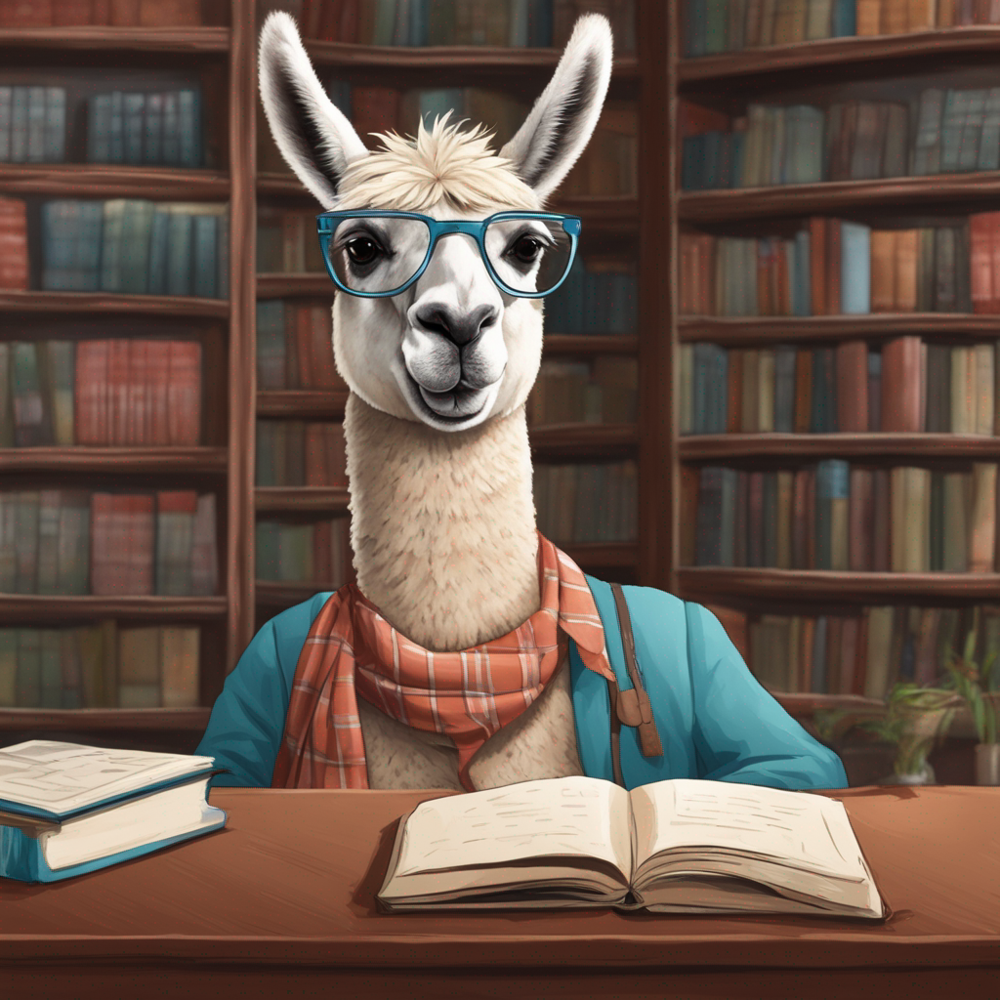

In [5]:
prompt = "A intelligent llama wearing a glass to teach english in a library"

# run both experts
image = base(prompt=prompt, num_inference_steps=n_steps, denoising_end=high_noise_frac, output_type="latent").images
image = refiner(prompt=prompt, num_inference_steps=n_steps, denoising_start=high_noise_frac, image=image).images[0]
image

In [3]:
prompt = "An astronaut riding a green horse"

images = pipe(prompt=prompt).images[0]

100%|████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:32<00:00,  1.54it/s]


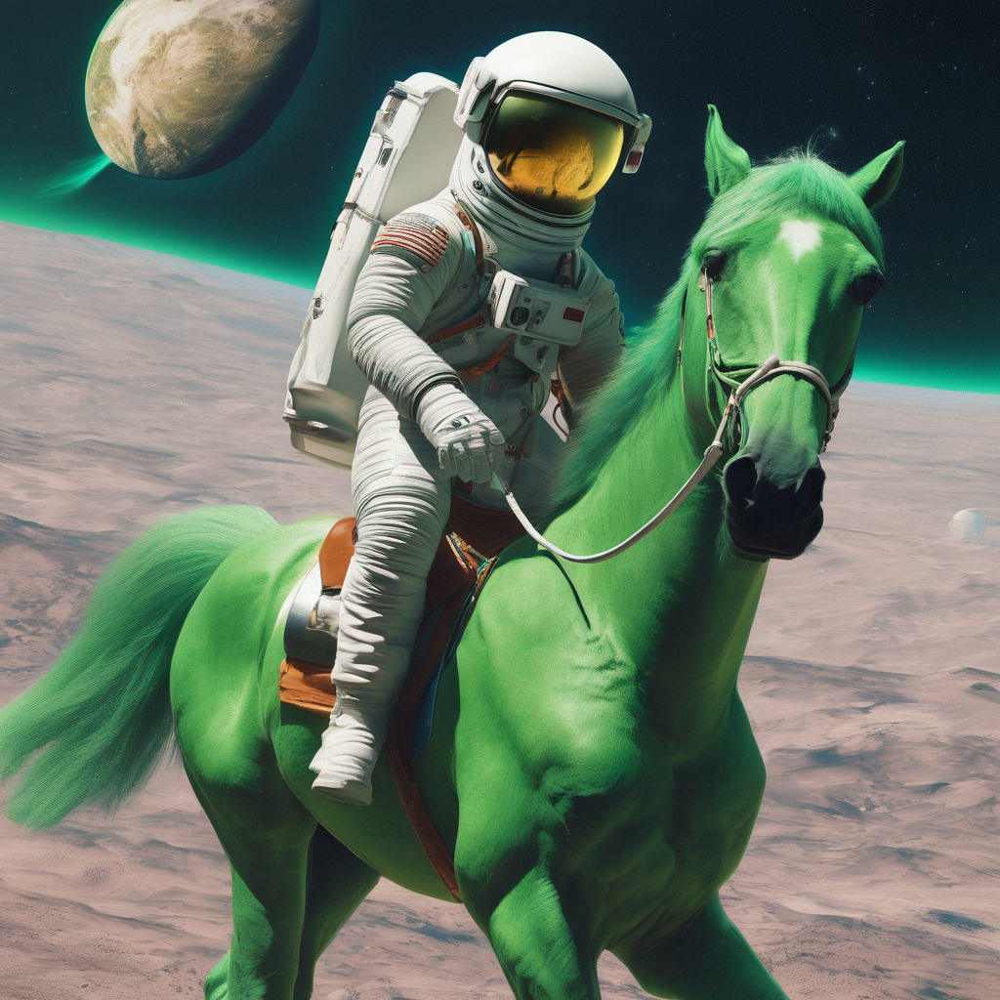

In [4]:
images

# SDXL Turbo

In [1]:
from diffusers import AutoPipelineForText2Image
import torch

pipe = AutoPipelineForText2Image.from_pretrained("stabilityai/sdxl-turbo", torch_dtype=torch.float16, variant="fp16")
# pipe.unet = torch.compile(pipe.unet, mode="reduce-overhead", fullgraph=True)
pipe.to("cuda")
# pipe.enable_model_cpu_offload()

prompt = "A cinematic shot of a baby racoon wearing an intricate italian priest robe."

image = pipe(prompt=prompt, num_inference_steps=1, guidance_scale=0.0).images[0]

/home/skim/.pyenv/versions/sd/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
100%|██████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.62it/s]


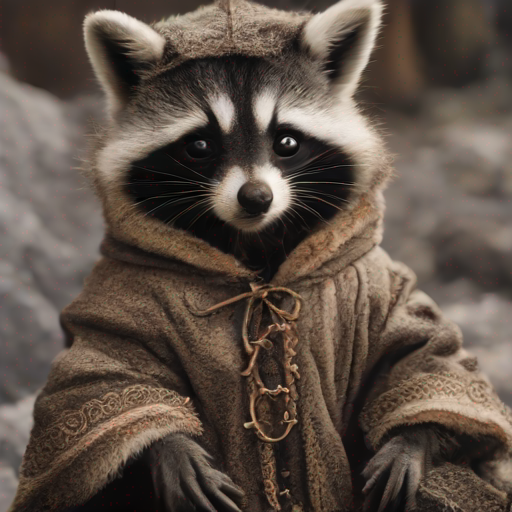

In [2]:
image

100%|██████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 15.22it/s]


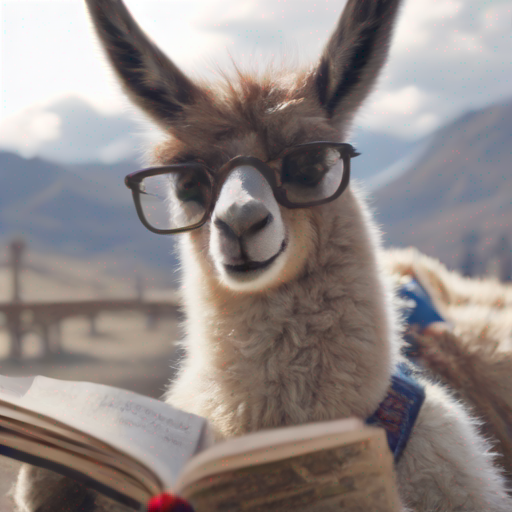

In [13]:
prompt = "A cinematic shot of an llama wearing a glass holding an English textbook."

image = pipe(prompt=prompt, num_inference_steps=1, guidance_scale=0.0).images[0]
image

In [14]:
image.save("output/llama_reading.jpg")

100%|██████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 12.85it/s]


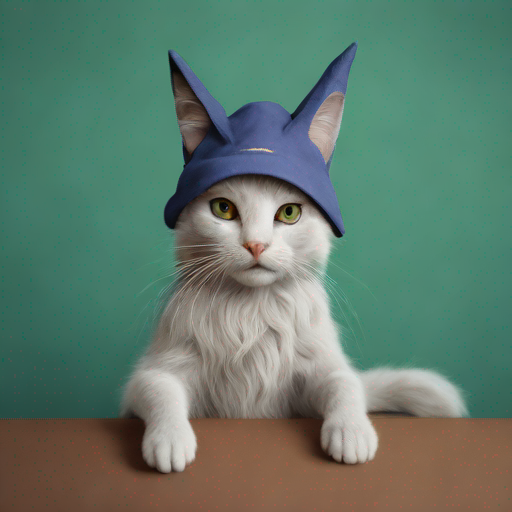

In [15]:
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import load_image
import torch

pipe = AutoPipelineForImage2Image.from_pretrained("stabilityai/sdxl-turbo", torch_dtype=torch.float16, variant="fp16")
pipe.to("cuda")

init_image = load_image(
    "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/cat.png"
).resize((512, 512))

prompt = "cat wizard, gandalf, lord of the rings, detailed, fantasy, cute, adorable, Pixar, Disney, 8k"

image = pipe(prompt, image=init_image, num_inference_steps=2, strength=0.5, guidance_scale=0.0).images[0]

image

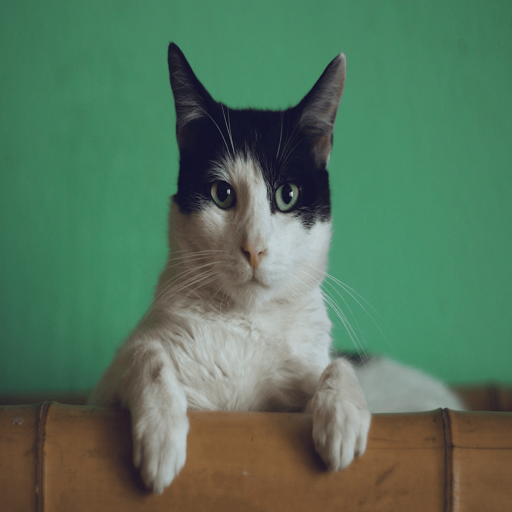

In [16]:
init_image

100%|██████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 16.50it/s]


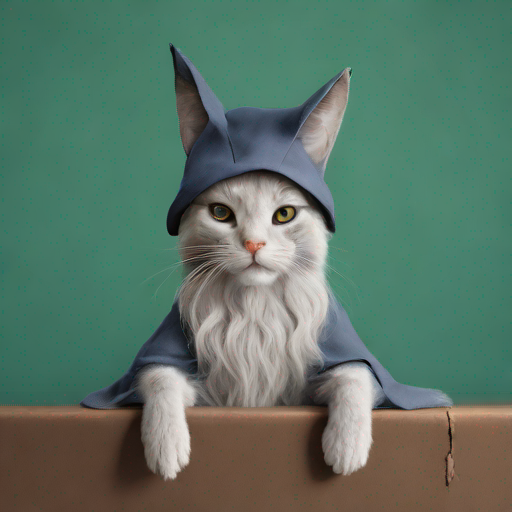

In [22]:
image = pipe(prompt, image=init_image, num_inference_steps=2, strength=0.5, guidance_scale=0.0).images[0]
image